# Ensemble prediction for difficult tiles

This version is for models in .pth format and Triton.  
It is possible to use different models with differenf image sizes (image size must be multiple of 32).  
For Triton you need to use separate models for every size.  

 - To find a burned-out area with a minimum error in difficult cases (early spring, late autumn, smoke, clouds), you can use ensembles of several models with different image sizes.
 - The size must be a multiple of 32 and not bigger than the minimum dimention of tile.
 - Using an ensemble of models and different sizes increases the prediction time, but decreases the error probability.

### [Single tile processing](#single)
 - Example of single tiile processing.

### [Batch processing - tiles from test region](#batch)
 - Batch processing example.

### [Ensemble to onnx format](#toonnx)
 - Example of converting ensemble into one .onnx model for Triton

### [Batch processing - tiles from test region with Triton ensemble](#triton)
 - Batch processing example with Triton ensemble.

For tiles with fire and smoke model2 and model5 work better.

In [1]:
import glob
import os
import shutil

import matplotlib.pyplot as plt
import numpy as np
import torch.onnx
from IPython.core.interactiveshell import InteractiveShell
from IPython.display import clear_output
from torch import nn
from torch.autograd import Variable
from tqdm import tqdm

from utils.detect import *
from utils.fast_ensemble import *

InteractiveShell.ast_node_interactivity = "all"

In [2]:
CHANELS = ["B11", "B08", "B02"]
DEVICE = "cuda"
MAX_BATCH_SIZE = 8
TIFF_PATH = [
    x.replace("response.tiff", "") for x in glob.glob("/app/data/test_tiff/*/*.tiff")
]
MODEL_PATHS = sorted(glob.glob("/app/models/*.pth"))
print(f"Model names: {[x.split('/')[-1].split('.')[0] for x in MODEL_PATHS]}")

Model names: ['model1', 'model2', 'model3', 'model4', 'model5', 'model6', 'model7']


# Ensemble as one model

In [3]:
model = make_ensemble(models_paths=MODEL_PATHS, device=DEVICE, for_onnx=False)

Using device: cuda
Using device: cuda
Using device: cuda
Using device: cuda
Using device: cuda
Using device: cuda
Using device: cuda


<a id='single'></a>

# Single tile processing

In [4]:
INTERSECTIONS = [0.3, 0.2, 0.15]
MAX_BATCH_SIZE = 8
IMG_SIZES = [384, 512, 1024]
ENSEMBLE_THRESHOLD = (len(MODEL_PATHS) * len(IMG_SIZES)) // 2 + 1
AREA_THRESHOLD = 500
MASK_THRESHOLD = 0.999

In [5]:
single_path = TIFF_PATH[24]
ds, img, total_mask, size_intersection = get_ensemble_masks(
    path=single_path,
    model=model,
    single_threshold=MASK_THRESHOLD,
    img_sizes=IMG_SIZES,
    intersections=INTERSECTIONS,
    norm=True,
    n_models=len(MODEL_PATHS),
    device="cuda",
    max_batch_size=MAX_BATCH_SIZE,
    disable_rasterio_warning=True,
)

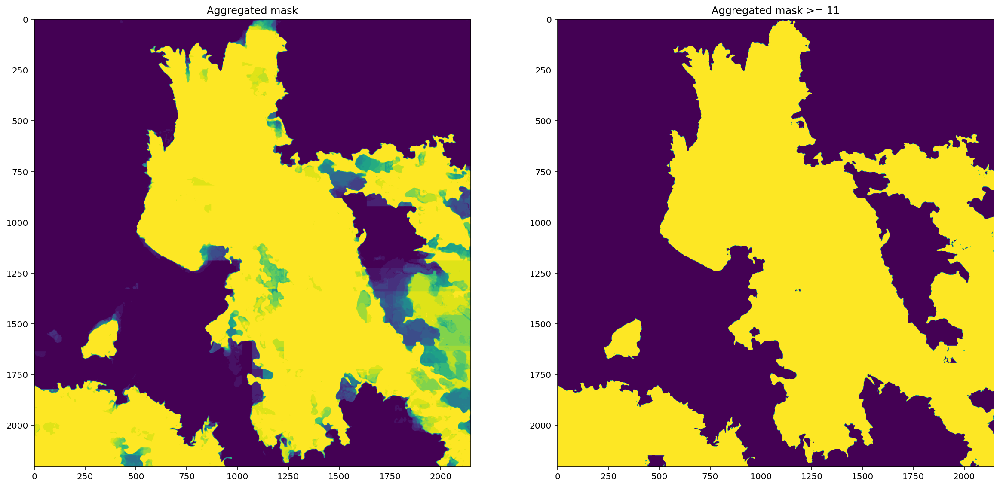

In [6]:
plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.title('Aggregated mask')
plt.imshow(total_mask)
plt.subplot(1, 2, 2)
plt.title(f'Aggregated mask >= {ENSEMBLE_THRESHOLD}')
plt.imshow(total_mask >= ENSEMBLE_THRESHOLD)
plt.show();

In [7]:
mask = np.where(total_mask >= ENSEMBLE_THRESHOLD, 1, 0)

In [8]:
%%time
all_img_coord = mask_to_polygon_coordinates(binary_mask=mask)
all_img_polygons = coordinates_to_polygons(coordinates=all_img_coord)
list_big_polygons = area_filter(
    all_img_polygons=all_img_polygons, area_threshold=AREA_THRESHOLD
)
img_coord = [
    all_img_coord[i] for i in range(len(all_img_coord)) if i in list_big_polygons
]
img_polygons = coordinates_to_polygons(coordinates=img_coord)
geo_coord = get_geo_coordinates(rasterio_dataset=ds, img_coordinates=img_coord)
list_true_polygons, list_holes = detect_holes(
    img_polygons=img_polygons, predicted_mask=mask, buffer_pixels=2
)
approximate_geo_polygons = coordinates_to_polygons(
    coordinates=[geo_coord[x] for x in list_true_polygons]
)

dict_polygons = detect_inner_polygons(
    img_polygons=img_polygons,
    list_true_polygons=list_true_polygons,
    list_holes=list_holes,
)
geo_polygons = make_geo_polygons(
    dict_inner_polygons=dict_polygons,
    geo_coordinates=geo_coord,
    list_true_polygons=list_true_polygons,
)

CPU times: user 1.15 s, sys: 18.3 ms, total: 1.17 s
Wall time: 1.17 s


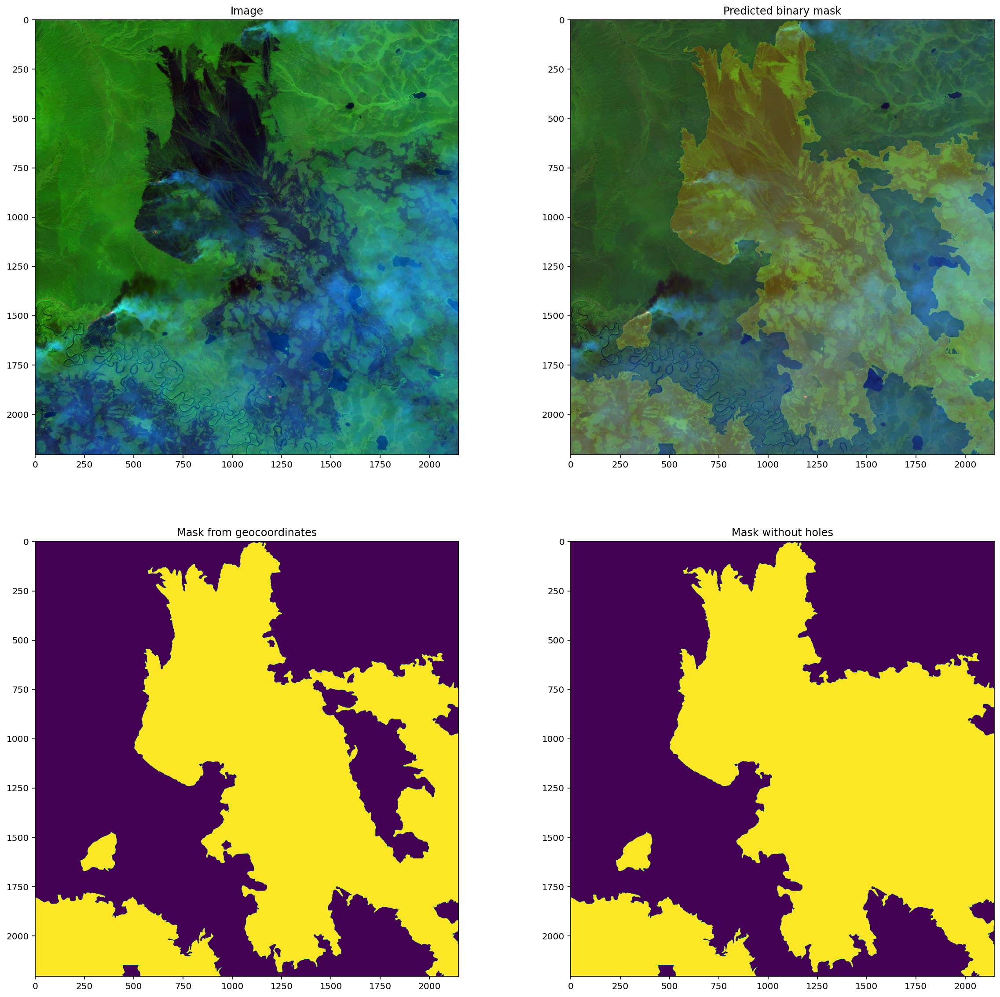

In [9]:
plot(
    image=img,
    binary_mask=mask,
    geo_polygons=geo_polygons,
    rasterio_dataset=ds,
    approx_polygons=approximate_geo_polygons,
)

<a id='batch'></a>

## Batch processing - tiles from test region

In [10]:
TEST_REGION_PATH = glob.glob("/app/data/ig_tiff_21/*/")
INTERSECTIONS = [0.2, 0.1]
MAX_BATCH_SIZE = 8
IMG_SIZES = [384, 1024]  # size 1024 is bigger than image size, it will be recalculated
ENSEMBLE_THRESHOLD = 8 # up to n_models*len(IMG_SIZES)
AREA_THRESHOLD = 100
MASK_THRESHOLD = 0.999

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


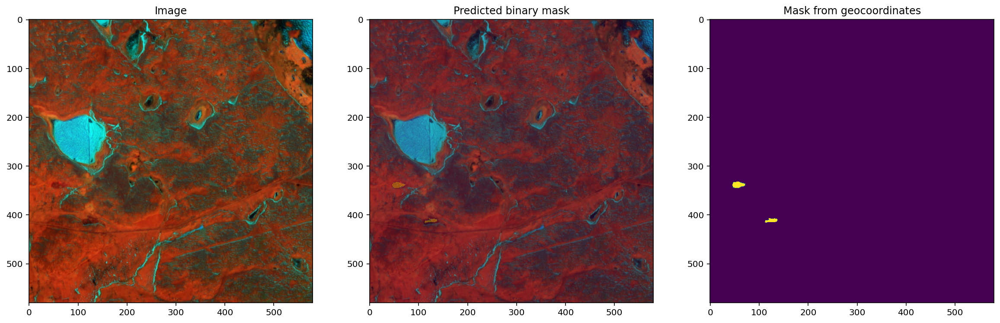

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


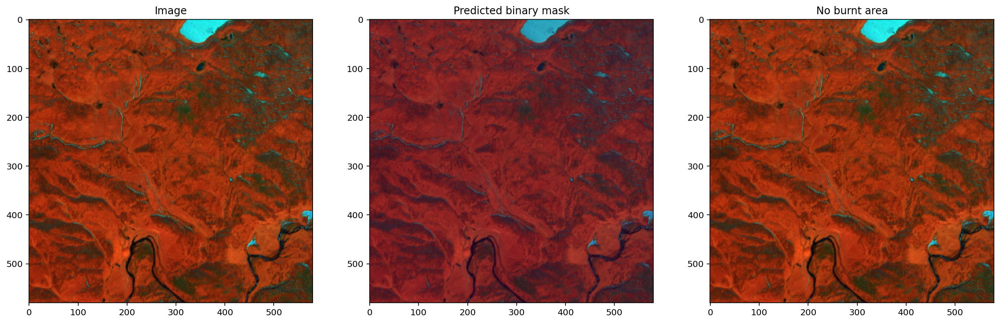

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


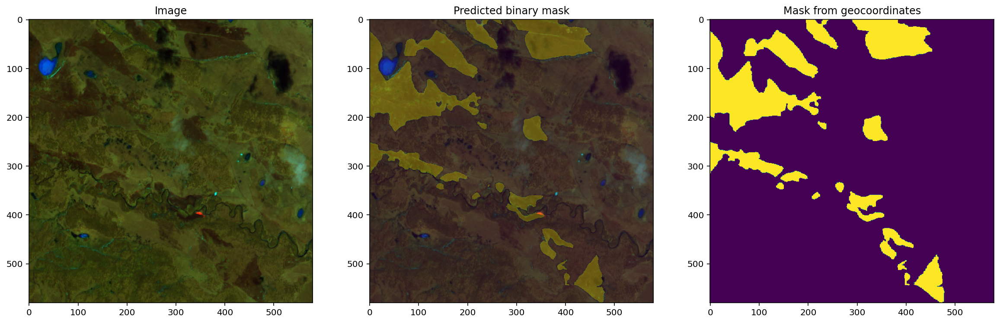

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


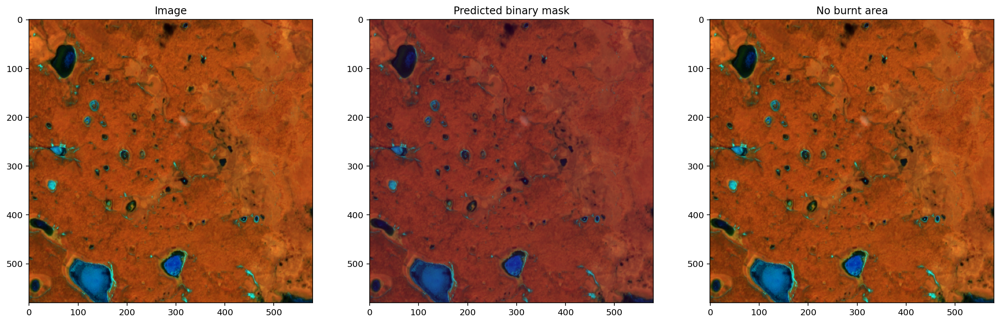

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


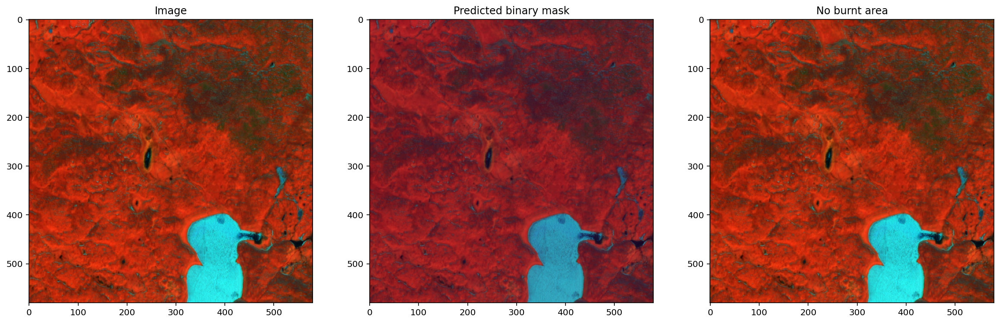

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


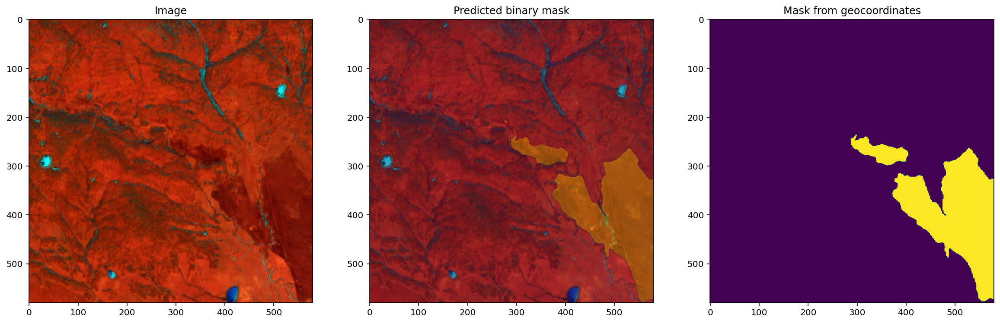

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


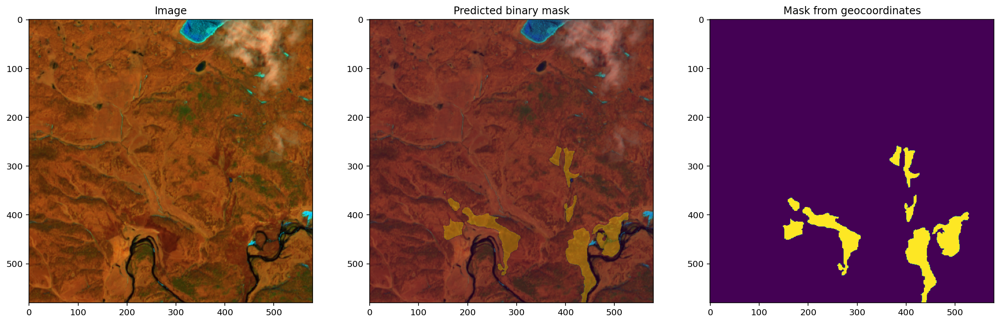

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


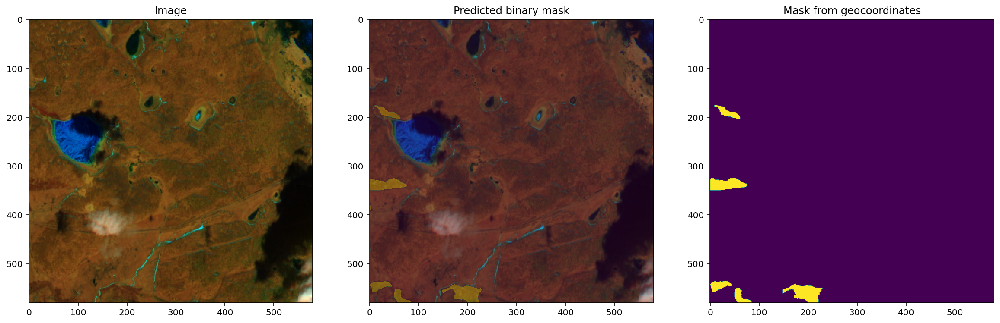

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


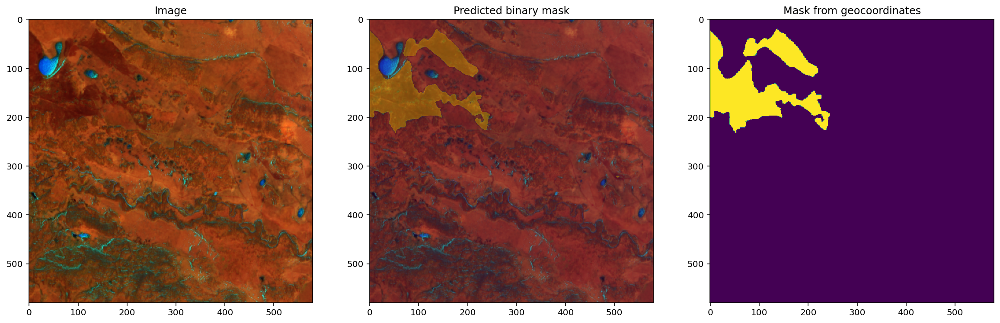

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


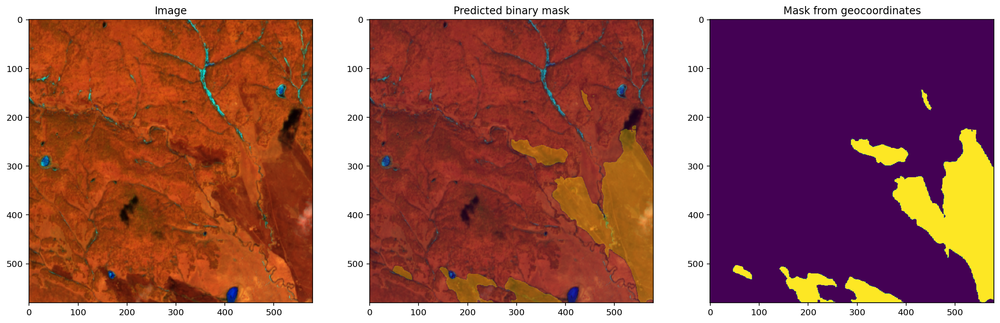

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


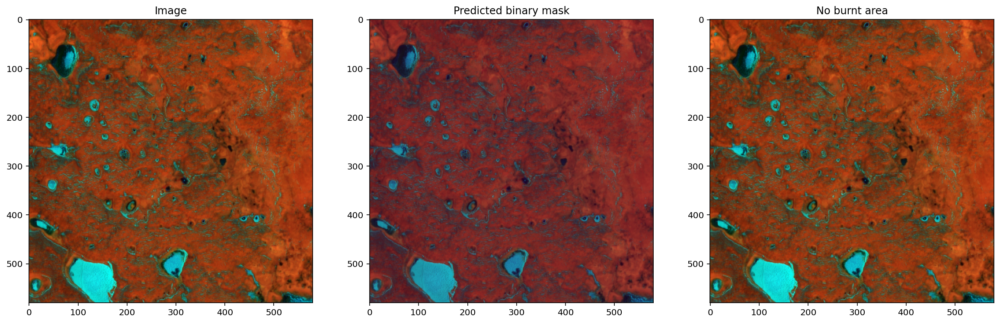

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


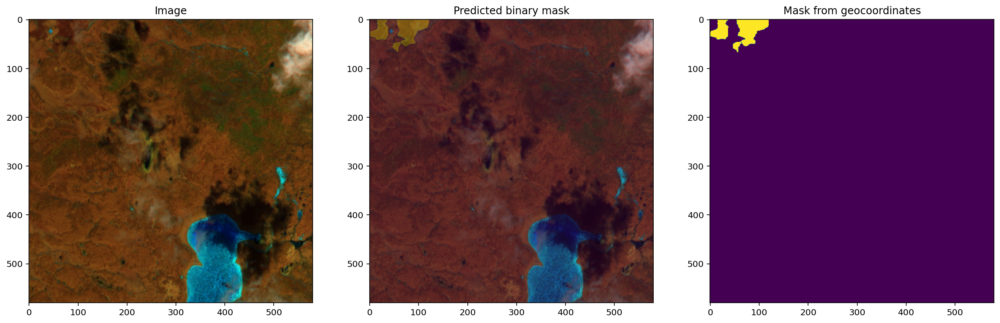

CPU times: user 34.7 s, sys: 3.31 s, total: 38.1 s
Wall time: 30.5 s


In [11]:
%%time
for single_path in TEST_REGION_PATH:
    ds, img, total_mask, size_intersection = get_ensemble_masks(
        path=single_path,
        model=model,
        single_threshold=MASK_THRESHOLD,
        img_sizes=IMG_SIZES,
        intersections=INTERSECTIONS,
        norm=True,
        n_models=7,
        device="cuda",
        max_batch_size=MAX_BATCH_SIZE,
        disable_rasterio_warning=False,
    )
    if img is not None:
        mask = np.where(total_mask >= ENSEMBLE_THRESHOLD, 1, 0)
        all_img_coord = mask_to_polygon_coordinates(binary_mask=mask)
        all_img_polygons = coordinates_to_polygons(coordinates=all_img_coord)
        list_big_polygons = area_filter(
            all_img_polygons=all_img_polygons, area_threshold=AREA_THRESHOLD
        )
        img_coord = [
            all_img_coord[i]
            for i in range(len(all_img_coord))
            if i in list_big_polygons
        ]
        img_polygons = coordinates_to_polygons(coordinates=img_coord)
        geo_coord = get_geo_coordinates(rasterio_dataset=ds, img_coordinates=img_coord)
        list_true_polygons, list_holes = detect_holes(
            img_polygons=img_polygons, predicted_mask=mask, buffer_pixels=2
        )
        approximate_geo_polygons = coordinates_to_polygons(
            coordinates=[geo_coord[x] for x in list_true_polygons]
        )

        dict_polygons = detect_inner_polygons(
            img_polygons=img_polygons,
            list_true_polygons=list_true_polygons,
            list_holes=list_holes,
        )
        geo_polygons = make_geo_polygons(
            dict_inner_polygons=dict_polygons,
            geo_coordinates=geo_coord,
            list_true_polygons=list_true_polygons,
        )
        plot(
            image=img,
            binary_mask=mask,
            geo_polygons=geo_polygons,
            rasterio_dataset=ds,
            approx_polygons=None,
        )
        plt.show()

___
IMG_SIZES = [384, 1024]  
INTERSECTIONS = [0.2, 0.1]  
Since image size for model prediction 1024 is bigger than tile size it was recalculated into 544:

In [12]:
size_intersection

[[384, 0.2], [544, 0.1]]

 - For those tiles with one ensemble model prediction the mean time is 8.7 s for 12 tiles, it is 0.725 s per tile.
 - For one model and one size (384x384) mean time is 1.43s for 12 tiles, it is 0.119s per tile.
 - With 7 models and 2 sizes time is 6.1 bigger.

<a id='toonnx'></a>

## Ensemble to onnx format

For Triton for every model image size is fixed, that's why for several sizes you need to save several models.
Models are placed in "models" folder, for example: /models/ensemble_7_512/1/model.onnx.
In every folder you need to place config.pbtxt where you must define model name, input size, output size:
~~~
name: "ensemble_7_512"

input [
  {
    name: "input"
    data_type: TYPE_FP32
    dims: [  3 , 512  , 512 ]
  }
]
output [
  {
    name: "output"
    data_type: TYPE_FP32
    dims: [ 7, 512 ,512 ]
  }
]
~~~

In output first dimention is number of models in ensemble.
So the models folder looks like:
- models/
    - model1/
        - config.pbtxt
        - 1/
            - model.onnx
    - ensemble_7_512/
        - config.pbtxt
        - 1/
            - model.onnx

In [13]:
model_for_onnx = make_ensemble(models_paths=MODEL_PATHS, device=DEVICE, for_onnx=True)

Using device: cuda
Using device: cuda
Using device: cuda
Using device: cuda
Using device: cuda
Using device: cuda
Using device: cuda


In [14]:
ENSEMBLE_SIZE = 512

In [15]:
ensemble_to_onnx(
    torch_model=model_for_onnx,
    onnx_path="/app/models/onnx/",
    model_name=f"ensemble_{len(MODEL_PATHS)}_{ENSEMBLE_SIZE}",
    device="cuda",
    img_size=ENSEMBLE_SIZE,
)

<a id='triton'></a>

## Batch processing - tiles from test region with Triton ensemble

In [16]:
TRITON_HTTP_SERVICE_URL = "172.17.0.1:18000"

triton_client = httpclient.InferenceServerClient(
    url=TRITON_HTTP_SERVICE_URL,
    verbose=False,
    connection_timeout=600,  # may be needed to wait for tensorrt to run optimization on first call
    network_timeout=600,
    concurrency=1,
)
triton_client.get_model_repository_index()

[{'name': 'ensemble_384', 'version': '1', 'state': 'READY'},
 {'name': 'ensemble_512', 'version': '1', 'state': 'READY'},
 {'name': 'model1', 'version': '1', 'state': 'READY'},
 {'name': 'model2', 'version': '1', 'state': 'READY'}]

In [17]:
TRITON_MODEL_NAMES = ["ensemble_384", "ensemble_512"]
IMG_SIZES = [384, 512]  # only sizes of triton ensemble models, for tiiles more than 1024*1024 pixels it is recomended to make "ensemble_384", "ensemble_512", "ensemble_1024"
MAX_BATCH_SIZE = 8

for model_name, img_size in zip(TRITON_MODEL_NAMES, IMG_SIZES):
    start_triton(
        max_batch_size=MAX_BATCH_SIZE,
        triton_http_service_url=TRITON_HTTP_SERVICE_URL,
        img_size=img_size,
        model_name=model_name,
    )

In [18]:
TEST_REGION_PATH = glob.glob("/app/data/ig_tiff_21/*/")
INTERSECTIONS = [0.2, 0.1]
MASK_THRESHOLD = 0.999
ENSEMBLE_THRESHOLD = 8 # up to n_models * len(TRITON_MODEL_NAMES)
AREA_THRESHOLD = 100

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


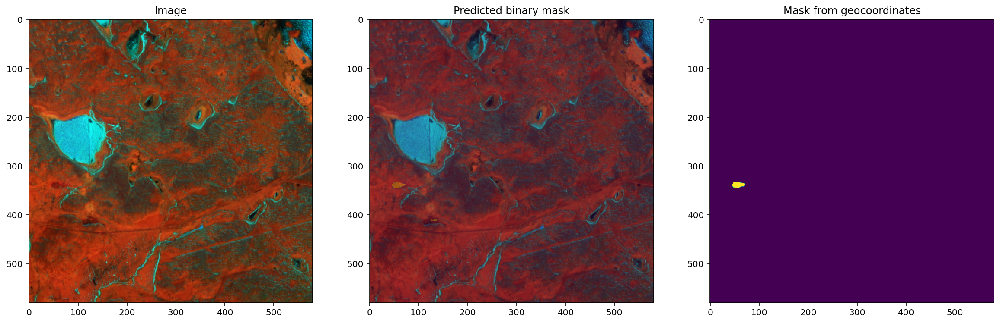

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


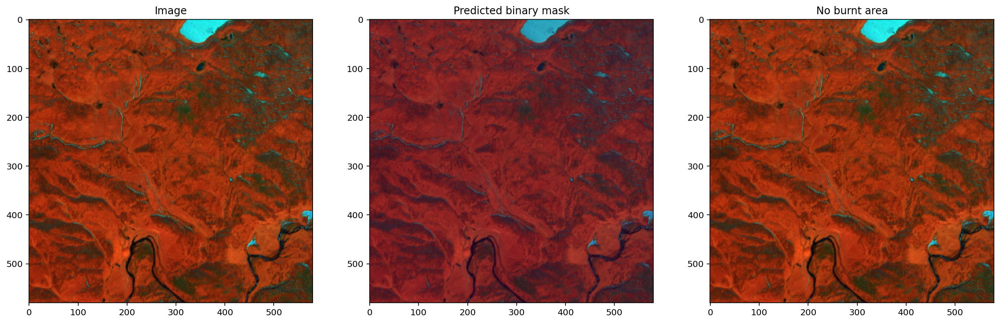

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


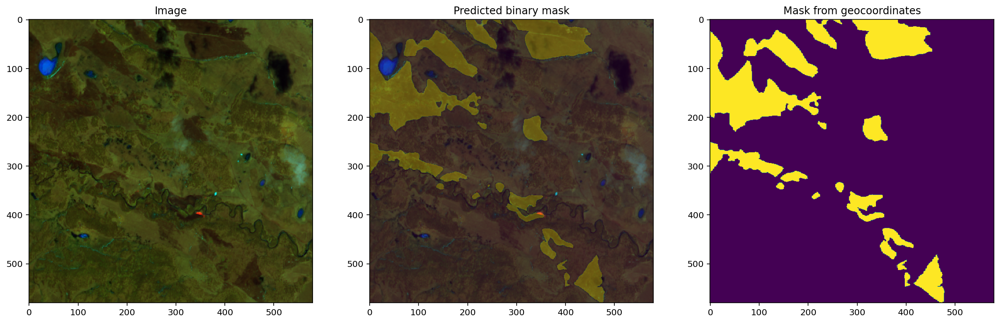

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


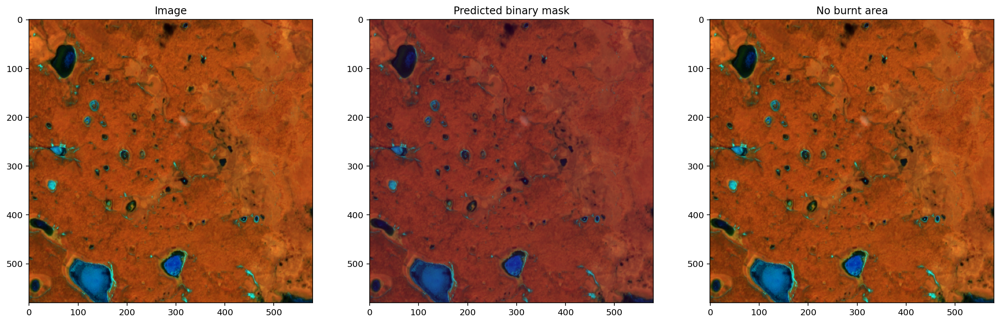

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


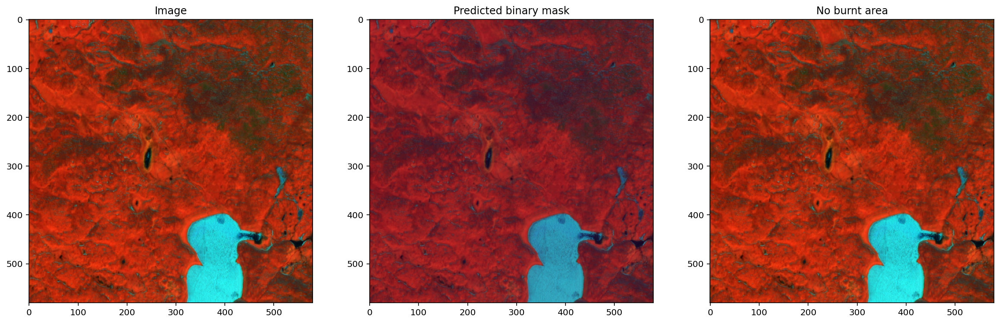

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


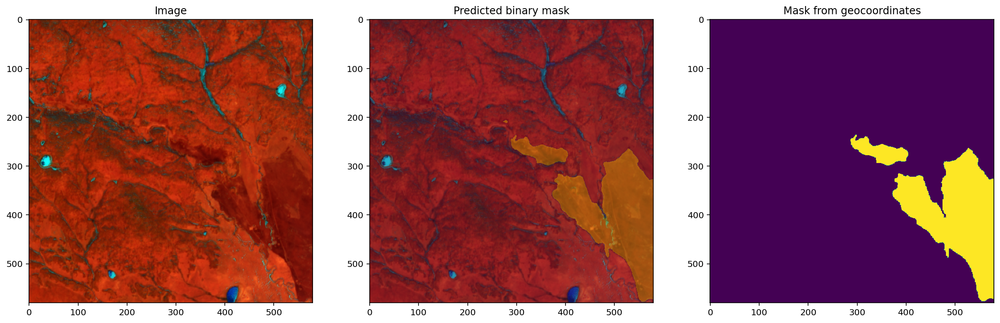

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


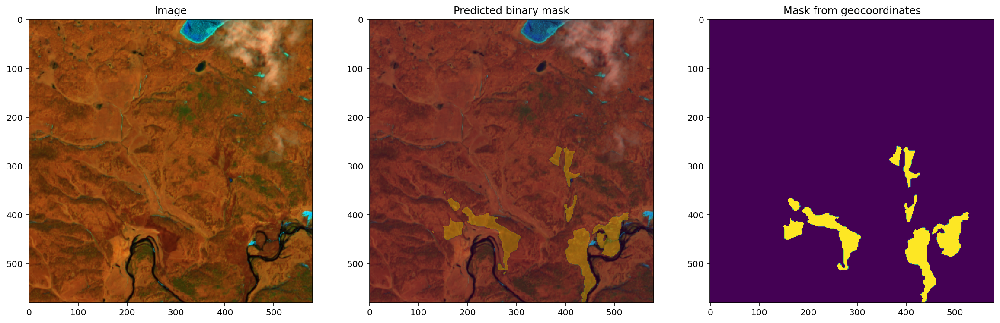

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


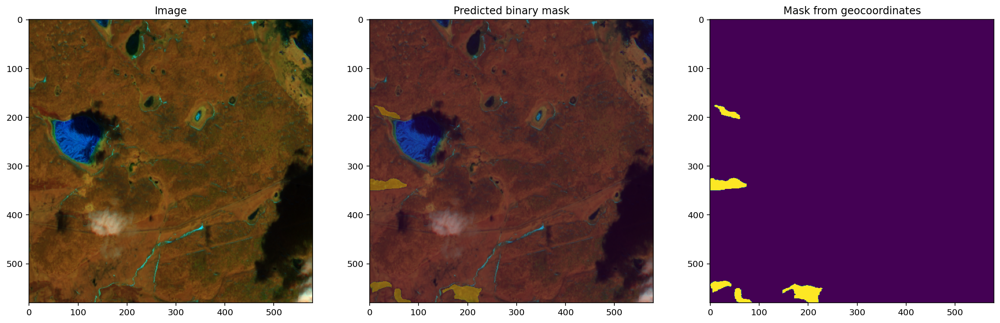

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


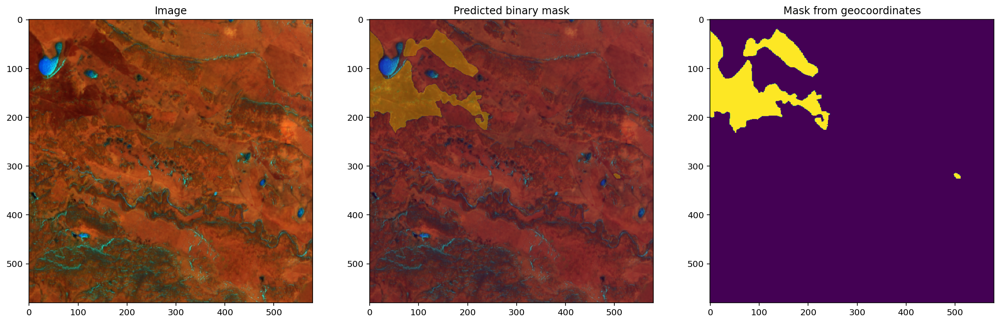

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


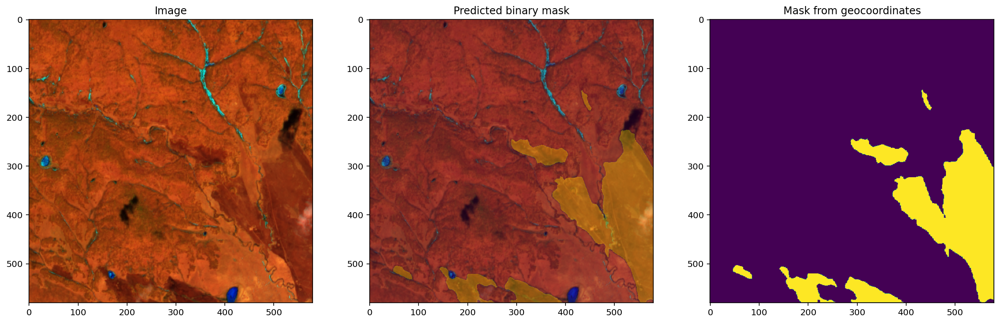

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


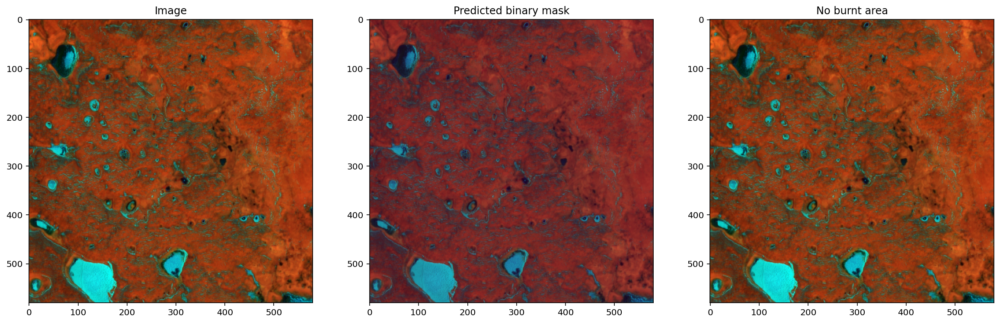

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


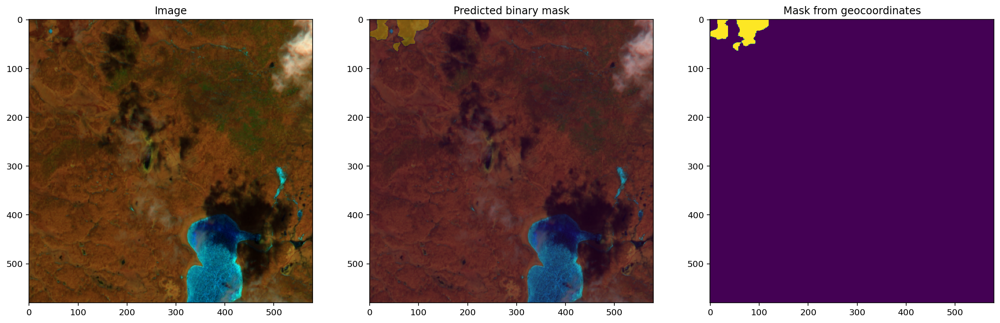

CPU times: user 27 s, sys: 3.87 s, total: 30.9 s
Wall time: 28 s


In [21]:
%%time
for single_path in TEST_REGION_PATH:
    ds, img, total_mask = triton_ensemble_predict(
        path=single_path,
        triton_model_names=TRITON_MODEL_NAMES,
        triton_http_service_url=TRITON_HTTP_SERVICE_URL,
        single_threshold=MASK_THRESHOLD,
        img_sizes=IMG_SIZES,
        intersections=INTERSECTIONS,
        norm=True,
        n_models=7,
        max_batch_size=MAX_BATCH_SIZE,
        disable_rasterio_warning=False, #set to True if you don't need to show images
    )
    if img is not None:
        mask = np.where(total_mask >= ENSEMBLE_THRESHOLD, 1, 0)
        all_img_coord = mask_to_polygon_coordinates(binary_mask=mask)
        all_img_polygons = coordinates_to_polygons(coordinates=all_img_coord)
        list_big_polygons = area_filter(
            all_img_polygons=all_img_polygons, area_threshold=AREA_THRESHOLD
        )
        img_coord = [
            all_img_coord[i]
            for i in range(len(all_img_coord))
            if i in list_big_polygons
        ]
        img_polygons = coordinates_to_polygons(coordinates=img_coord)
        geo_coord = get_geo_coordinates(rasterio_dataset=ds, img_coordinates=img_coord)
        list_true_polygons, list_holes = detect_holes(
            img_polygons=img_polygons, predicted_mask=mask, buffer_pixels=2
        )
        approximate_geo_polygons = coordinates_to_polygons(
            coordinates=[geo_coord[x] for x in list_true_polygons]
        )

        dict_polygons = detect_inner_polygons(
            img_polygons=img_polygons,
            list_true_polygons=list_true_polygons,
            list_holes=list_holes,
        )
        geo_polygons = make_geo_polygons(
            dict_inner_polygons=dict_polygons,
            geo_coordinates=geo_coord,
            list_true_polygons=list_true_polygons,
        )
        plot(
            image=img,
            binary_mask=mask,
            geo_polygons=geo_polygons,
            rasterio_dataset=ds,
            approx_polygons=None,
        )
        plt.show()

 - For those tiles with Triton ensemble the mean time is 6.57 s for 12 tiles, it is 0.5475 s per tile.
 - For one model and one size (384x384) mean time is 1.43s for 12 tiles, it is 0.119s per tile.
 - With Triton ensemble and 2 sizes time is 4.6 bigger.